In [2]:
%config Completer.use_jedi = False

import glob
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
from datetime import datetime
from dateutil import relativedelta
from datetime import timedelta
import warnings
warnings.filterwarnings('ignore') #igonora qualquer aviso!


In [3]:
# Caminhos dos diretórios raiz                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        
# general_path = 'C:/Users/cnalm/OneDrive/Hidroweb'    # Caminho do projeto (Cristiano)
# general_path = 'D:/Dados_Nuvem/OneDrive/Hidroweb'   # Colocar aqui o caminho de Filipe
general_path = r'C:/Users/linde/OneDrive/Hidroweb'   # Colocar aqui o caminho de Lindemberg

# Reading hdf files

In [4]:
df_filter_pr = pd.read_hdf(general_path 
                           + '/Consolidated Files/TELEMETRIA/TELEMETRIA_DATA_DAILY.h5')
df_filter_pr.columns = ["Code", "Date", "Value"]
df_filter_pr

,Code,Date,Value
0,02042051,2021-07-31,0.0
1,02042051,2021-08-01,1.0
2,02042051,2021-08-02,0.0
3,02042051,2021-08-03,0.6
4,02042051,2021-08-04,1.0
...,...,...,...
1923107,88690050,2023-12-27,0.0
1923108,88690050,2023-12-28,0.0
1923109,88690050,2023-12-29,2.0
1923110,88690050,2023-12-30,0.0


In [5]:
df_gauges = pd.read_hdf(general_path
                        + '/Consolidated Files/TELEMETRIA/TELEMETRIA_INFO.h5')
df_gauges = df_gauges[["gauge_code", "state"]]
df_gauges.columns = ["Code", "State"]
df_gauges.drop_duplicates(ignore_index=True, inplace=True)
df_gauges

,Code,State
0,12370000,AC
1,12500000,AC
2,12510500,AC
3,12557000,AC
4,12590000,AC
...,...,...
2313,23100100,TO
2314,23495000,TO
2315,26795140,TO
2316,26795200,TO


In [6]:
df_filter_pr_state = df_filter_pr.merge(df_gauges, how = 'left', on = 'Code')
df_filter_pr_state['Date'] = pd.to_datetime(df_filter_pr_state['Date'])
df_filter_pr_state['Year'] = df_filter_pr_state['Date'].dt.year
state_list = df_filter_pr_state['State'].drop_duplicates().sort_values().tolist()
df_filter_pr_state

,Code,Date,Value,State,Year
0,02042051,2021-07-31,0.0,MG,2021
1,02042051,2021-08-01,1.0,MG,2021
2,02042051,2021-08-02,0.0,MG,2021
3,02042051,2021-08-03,0.6,MG,2021
4,02042051,2021-08-04,1.0,MG,2021
...,...,...,...,...,...
1923107,88690050,2023-12-27,0.0,RS,2023
1923108,88690050,2023-12-28,0.0,RS,2023
1923109,88690050,2023-12-29,2.0,RS,2023
1923110,88690050,2023-12-30,0.0,RS,2023


# P

In [ ]:
def calculateP(state):
    df_filter_pr_state_filter = df_filter_pr_state[(df_filter_pr_state['State'] == state)]
    station_list = df_filter_pr_state_filter['Code'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
    df_p = pd.DataFrame(columns = ["Code", "Date", "Availability"])
    count = 0
    print(state)
    for station in station_list:
        count = count + 1
        list_code = []
        list_date = []
        list_availabity = []
        print(count, '/', len(station_list))
        df_temp_station = df_filter_pr_state_filter[(df_filter_pr_state_filter['Code'] == station)]
        # max_year = max(df_temp_station['Year'].values.tolist())
        # min_year = min(df_temp_station['Year'].values.tolist())
        year_list = df_temp_station['Year'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
        # print(min_year, max_year, year_list)
        # print(df_temp_station)
        for year in year_list:
            df_temp_station_year = df_temp_station[(df_temp_station['Year'] == year)]
            df_temp_station_year['Month'] = df_temp_station_year['Date'].dt.month
            list_month = df_temp_station_year['Month'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
            # print(list_month)
            for month in list_month:
                # print(station, year, month)
                df_temp_station_month = df_temp_station_year[(df_temp_station_year['Month'] == month)]
        #         print(df_temp_station_year)
                first_day = datetime(year, month, 1)
                last_day = first_day + relativedelta.relativedelta(months=1)
                period_length = (last_day - first_day).days
                row_count = len(df_temp_station_month)
                period_availabity = row_count / period_length * 100.0
                # print(first_day, row_count, period_length, period_availabity)
                list_code.append(station)
                list_date.append(first_day)
                list_availabity.append(period_availabity)
                # print(list_code)
                # print(list_date)
                # print(list_availabity)
        df_station_availabity = pd.DataFrame(list(zip(list_code, list_date, list_availabity)),
                                             columns =['Code', 'Date', 'Availability'])
        # print(list_date)
        # print(list_availabity)
        df_p = pd.concat([df_p, df_station_availabity], ignore_index = True)
        df_p['State'] = state
        # print(df_p)
    df_p.to_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\P\MENSAL\UF\\"+state+r"_by_month.h5", 'table_data', mode = 'w', append = False, complevel = 9, encoding="cp860")
    # data = np.array(df_p['Availability'])
    # plt.rcParams["figure.figsize"] = (10, 5)
    # plt.hist(data, bins = 10, edgecolor='black', color = 'grey') #data and number of bins
    # tnr = {'fontname':'Times New Roman', 'fontsize':12}
    # plt.xlim(0, 100)
    # plt.axvline(data.mean(), color='k', linestyle='dashed', linewidth=2)
    # plt.tight_layout()
    # plt.savefig(general_path+'/Figures/p_completeness_'+state+'_by_month.jpeg', format='jpeg', dpi=1200, bbox_inches='tight') 
    # plt.show()
    # plt.close()
    # print("mean", data.mean())
    # print("median", statistics.median(data))
    # print("mode", statistics.mode(data))
    # print(df_p.head())

In [ ]:
state = "SE"
calculateP(state)
for state in state_list:
    calculateP(state)
df_teste = pd.read_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\P\MENSAL\UF\\"+state+r"_by_month.h5")
df_teste

In [ ]:
all_files = glob.glob(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\P\MENSAL\UF\*.h5")
count = 0
df = []
for filename in all_files:
    df = pd.read_hdf(filename)
    df.reset_index(inplace=True, drop = True)
    if count == 0:
        df_total = df.copy(deep = True)
    else:
        df_total = pd.concat([df_total, df], ignore_index = True)
    count = count + 1
    print("File", count,"|", filename)
print(count, "files are loaded")
df_total.to_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\P\MENSAL\\"+r"TELEMETRIA_P_by_month.h5", 'table_data', mode = 'w', append = False, complevel = 9, encoding="cp860")
df_total

In [6]:
df_total = pd.read_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\P\MENSAL\\"+r"TELEMETRIA_P_by_month.h5")
df_total

,Code,Date,Availability,State
0,12370000,2021-01-01,100.000000,AC
1,12370000,2021-02-01,100.000000,AC
2,12370000,2021-03-01,100.000000,AC
3,12370000,2021-04-01,100.000000,AC
4,12370000,2021-05-01,100.000000,AC
...,...,...,...,...
65748,28850000,2023-08-01,100.000000,TO
65749,28850000,2023-09-01,100.000000,TO
65750,28850000,2023-10-01,100.000000,TO
65751,28850000,2023-11-01,96.666667,TO


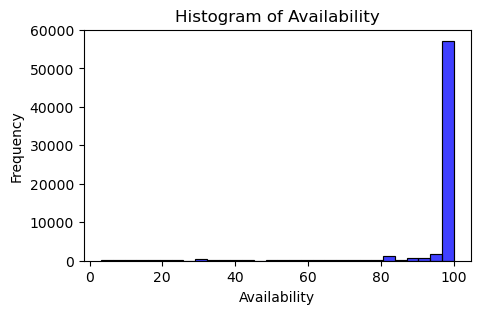

In [11]:
# Plotando o histograma
plt.figure(figsize=(5, 3))
sns.histplot(df_total["Availability"], bins=30, color='blue', kde=False)

# Configurando os rótulos e título
plt.xlabel('Availability')
plt.ylabel('Frequency')
plt.title('Histogram of Availability')

# Mostrando o gráfico
plt.show()
plt.close()

# Q1

In [26]:
def calculateQ1(state):
    df_filter_pr_state_filter = df_filter_pr_state[(df_filter_pr_state['State'] == state)]
    station_list = df_filter_pr_state_filter['Code'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
    df_q_gaps = pd.DataFrame(columns = ["Code", "Date", "Gaps"])
    count = 0
    print(state)
    for station in station_list:
        count = count + 1
        list_code = []
        list_date = []
        list_gaps = []
        print(count, '/', len(station_list))
        df_temp_station = df_filter_pr_state_filter[(df_filter_pr_state_filter['Code'] == station)]
        # max_year = max(df_temp_station['Year'].values.tolist())
        # min_year = min(df_temp_station['Year'].values.tolist())
        year_list = df_temp_station['Year'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
        # print(min_year, max_year, year_list)
        # print(df_temp_station)
        for year in year_list:
            df_temp_station_year = df_temp_station[(df_temp_station['Year'] == year)]
            df_temp_station_year['Month'] = df_temp_station_year['Date'].dt.month
            list_month = df_temp_station_year['Month'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
            # print(list_month)
            for month in list_month:
                print(station, year, month)
                df_temp_station_month = df_temp_station_year[(df_temp_station_year['Month'] == month)]
                min_date = min(df_temp_station_month['Date'])
                max_date = max(df_temp_station_month['Date'])
                first_day = datetime(year, month, 1)
                last_day = first_day + relativedelta.relativedelta(months=1)
                date_list = []
                today = first_day
                while today < last_day:
                    date_list.append(today)
                    today = today + timedelta(days=1)
                df_date_list = pd.DataFrame(date_list, columns=['Date'])
                count_ops = len(df_date_list)
                ### FILTERING DATE LIST BY OPERATION PERIOD
                df_date_list = df_date_list[(df_date_list['Date'] >= min_date) & (df_date_list['Date'] <= max_date)]
                df_analysis = df_date_list.merge(df_temp_station_year, how = 'left', on  = 'Date')
                df_analysis = df_analysis.sort_values(['Date'], ignore_index=True)
                df_void = df_analysis[(df_analysis['Value'].isnull())]
                df_void = df_void.sort_values(['Date'], ignore_index=True)
                count_gaps = len(df_void)
                gap_series = df_analysis['Value'].values.tolist()
    #             print(gap_series)
                gap_count = 0
                gap_max_len = 0
                for value in gap_series:
                    if math.isnan(value):
                        gap_count = gap_count + 1
                        # print(value, "gap count is", gap_count)
                        if gap_count > gap_max_len:
                            gap_max_len = gap_count
                            # print(value, "new gap max len", gap_max_len)
                    else:
                        gap_count = 0
                        # print(value, "gap count is zero", gap_count)
                q_gap = 100.0 - 100.0 * (((2.0 * count_gaps) + gap_max_len)/count_ops)
                if (q_gap < 0.0):
                    q_gap = 0.0
                print(count_ops, count_gaps, gap_max_len, q_gap)
                list_code.append(station)
                list_date.append(first_day)
                list_gaps.append(q_gap)
                # print(list_code)
                # print(list_date)
                # print(list_availabity)
        df_station_gaps = pd.DataFrame(list(zip(list_code, list_date, list_gaps)),
                                             columns =['Code', 'Date', 'Gaps'])
        # print(list_date)
        # print(list_availabity)
        df_q_gaps = pd.concat([df_q_gaps, df_station_gaps], ignore_index = True)
        df_q_gaps['State'] = state 
    df_q_gaps.to_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\UF\\"+state+r"_by_month.h5", 'table_data', mode = 'w', append = False, complevel = 9, encoding="cp860") # type: ignore
    # data = np.array(df_p['Availability'])
    # plt.rcParams["figure.figsize"] = (10, 5)
    # plt.hist(data, bins = 10, edgecolor='black', color = 'grey') #data and number of bins
    # tnr = {'fontname':'Times New Roman', 'fontsize':12}
    # plt.xlim(0, 100)
    # plt.axvline(data.mean(), color='k', linestyle='dashed', linewidth=2)
    # plt.tight_layout()
    # plt.savefig(general_path+'/Figures/p_completeness_'+state+'_by_month.jpeg', format='jpeg', dpi=1200, bbox_inches='tight') 
    # plt.show()
    # plt.close()
    # print("mean", data.mean())
    # print("median", statistics.median(data))
    # print("mode", statistics.mode(data))
    # print(df_p.head())

In [28]:
state_teste = "SE"
calculateQ1(state_teste)
for state in state_list:
    calculateQ1(state)
df_teste = pd.read_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\UF\\"+state_teste+r"_by_month.h5")
df_teste

31 4 3 64.51612903225806
30055000 2023 6
30 0 0 100.0
30055000 2023 7
31 0 0 100.0
30055000 2023 8
31 0 0 100.0
30055000 2023 9
30 0 0 100.0
30055000 2023 10
31 0 0 100.0
30055000 2023 11
30 0 0 100.0
30055000 2023 12
31 0 0 100.0
11 / 21
30072150 2023 5
31 0 0 100.0
30072150 2023 6
30 0 0 100.0
30072150 2023 7
31 0 0 100.0
30072150 2023 9
30 0 0 100.0
30072150 2023 10
31 0 0 100.0
30072150 2023 11
30 0 0 100.0
30072150 2023 12
31 0 0 100.0
12 / 21
30075000 2023 2
28 0 0 100.0
30075000 2023 3
31 0 0 100.0
30075000 2023 4
30 0 0 100.0
30075000 2023 5
31 0 0 100.0
30075000 2023 6
30 0 0 100.0
30075000 2023 7
31 0 0 100.0
30075000 2023 8
31 0 0 100.0
30075000 2023 9
30 0 0 100.0
30075000 2023 10
31 0 0 100.0
30075000 2023 11
30 0 0 100.0
30075000 2023 12
31 0 0 100.0
13 / 21
30080000 2021 8
31 0 0 100.0
30080000 2021 9
30 0 0 100.0
30080000 2021 10
31 0 0 100.0
30080000 2021 11
30 0 0 100.0
30080000 2021 12
31 0 0 100.0
30080000 2022 1
31 0 0 100.0
30080000 2022 2
28 0 0 100.0
30080000 20

,Code,Date,Gaps,State
0,49550000,2021-01-01,100.0,SE
1,49550000,2021-02-01,100.0,SE
2,49550000,2021-03-01,100.0,SE
3,49550000,2021-04-01,100.0,SE
4,49550000,2021-05-01,100.0,SE
...,...,...,...,...
173,50191000,2023-08-01,100.0,SE
174,50191000,2023-09-01,100.0,SE
175,50191000,2023-10-01,100.0,SE
176,50191000,2023-11-01,100.0,SE


In [29]:
all_files = glob.glob(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\UF\*.h5")
count = 0
df = []
for filename in all_files:
    df = pd.read_hdf(filename)
    df.reset_index(inplace=True, drop = True)
    if count == 0:
        df_total = df.copy(deep = True)
    else:
        df_total = pd.concat([df_total, df], ignore_index = True)
    count = count + 1
    print("File", count,"|", filename)
print(count, "files are loaded")
df_total.to_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\\"+r"TELEMETRIA_Q1_by_month.h5", 'table_data', mode = 'w', append = False, complevel = 9, encoding="cp860")
df_total

File 1 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\UF\AC_by_month.h5
File 2 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\UF\AL_by_month.h5
File 3 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\UF\AM_by_month.h5
File 4 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\UF\AP_by_month.h5
File 5 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\UF\BA_by_month.h5
File 6 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\UF\CE_by_month.h5
File 7 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\UF\DF_by_month.h5
File 8 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\UF\ES_by_month.h5
File 9 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\UF\GO_by_month.h5
File 10 | 

,Code,Date,Gaps,State
0,12370000,2021-01-01,100.0,AC
1,12370000,2021-02-01,100.0,AC
2,12370000,2021-03-01,100.0,AC
3,12370000,2021-04-01,100.0,AC
4,12370000,2021-05-01,100.0,AC
...,...,...,...,...
65748,28850000,2023-08-01,100.0,TO
65749,28850000,2023-09-01,100.0,TO
65750,28850000,2023-10-01,100.0,TO
65751,28850000,2023-11-01,100.0,TO


In [30]:
df_total = pd.read_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q1\MENSAL\\"+r"TELEMETRIA_Q1_by_month.h5")
df_total

,Code,Date,Gaps,State
0,12370000,2021-01-01,100.0,AC
1,12370000,2021-02-01,100.0,AC
2,12370000,2021-03-01,100.0,AC
3,12370000,2021-04-01,100.0,AC
4,12370000,2021-05-01,100.0,AC
...,...,...,...,...
65748,28850000,2023-08-01,100.0,TO
65749,28850000,2023-09-01,100.0,TO
65750,28850000,2023-10-01,100.0,TO
65751,28850000,2023-11-01,100.0,TO


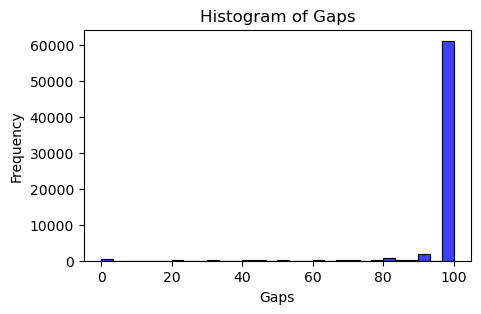

In [31]:
# Plotando o histograma
plt.figure(figsize=(5, 3))
sns.histplot(df_total["Gaps"], bins=30, color='blue', kde=False)

# Configurando os rótulos e título
plt.xlabel('Gaps')
plt.ylabel('Frequency')
plt.title('Histogram of Gaps')

# Mostrando o gráfico
plt.show()
plt.close()

# Q2

In [50]:
def calculateQ2(state):
    df_filter_pr_state_filter = df_filter_pr_state[(df_filter_pr_state['State'] == state)]
    station_list = df_filter_pr_state_filter['Code'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
    df_q_wd = pd.DataFrame(columns = ["Code", "Date", "Weekday"])
    count = 0
    print(state)
    for station in station_list:
        count = count + 1
        list_code = []
        list_date = []
        list_wd = []
        print(count, '/', len(station_list))
        df_temp_station = df_filter_pr_state_filter[(df_filter_pr_state_filter['Code'] == station)]
        # max_year = max(df_temp_station['Year'].values.tolist())
        # min_year = min(df_temp_station['Year'].values.tolist())
        year_list = df_temp_station['Year'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
        for year in year_list:
            df_temp_station_year = df_temp_station[(df_temp_station['Year'] == year)]
            df_temp_station_year['Month'] = df_temp_station_year['Date'].dt.month
            list_month = df_temp_station_year['Month'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
            # print(list_month)
            for month in list_month:
                # print(station, year, month)
                df_temp_station_month = df_temp_station_year[(df_temp_station_year['Month'] == month)]
                first_day = datetime(year, month, 1)
                last_day = first_day + relativedelta.relativedelta(months=1)
                date_list = []
                today = first_day
                while today < last_day:
                    date_list.append(today)
                    today = today + timedelta(days=1)
                df_date_list = pd.DataFrame(date_list, columns=['Date'])
                 ### FILTERING DATE LIST BY OPERATION PERIOD
                df_analysis = df_date_list.merge(df_temp_station_month, how = 'left', on  = 'Date')
                df_analysis = df_analysis.sort_values(['Date'], ignore_index=True)
                df_analysis['Weekday'] = df_analysis['Date'].dt.dayofweek
                df_rainy = df_analysis[df_analysis['Value'] > 0]
                df_rainy = df_rainy.reset_index(drop = True, inplace = False)
                df_count = df_rainy[['Weekday','Value']].groupby(['Weekday']).count()
                df_count = df_count.reset_index(drop = False)
                data = {
                'Weekday': [0,1,2,3,4,5,6]
                , 'zeros': [0,0,0,0,0,0,0]
                }
                df_zeros = pd.DataFrame(data)
                df_count = pd.merge(df_count, df_zeros, how = 'right', on = ['Weekday'])
                df_count['Value'] = df_count['Value'].fillna(0) + df_count['zeros']
                df_count['Value'] = df_count['Value'].astype(int)
                rainy_mean = float(df_count['Value'].mean())
                rainy_std = float(df_count['Value'].std())
                cv = 0.0
                if rainy_std > 0.0:
                    cv = rainy_std/rainy_mean
                q_wd = 100 - 100*cv
                if q_wd < 0:
                    q_wd = 0
                # print(df_count[['Weekday', 'Value']])
                print(rainy_std)
                print(rainy_mean)
                print(q_wd)
                list_code.append(station)
                list_date.append(first_day)
                list_wd.append(q_wd)
        df_station_wd = pd.DataFrame(list(zip(list_code, list_date, list_wd)),
                                             columns =['Code', 'Date', 'Weekday'])
        # print(list_date)
        # print(list_availabity)
        df_q_wd = pd.concat([df_q_wd, df_station_wd], ignore_index = True)
        df_q_wd['State'] = state 
    df_q_wd.to_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\UF\\"+state+r"_by_month.h5", 'table_data', mode = 'w', append = False, complevel = 9, encoding="cp860") # type: ignore

In [58]:
state_teste = "SE"
calculateQ2(state_teste)
for state in state_list:
    calculateQ2(state)
df_teste = pd.read_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\UF\\"+state_teste+r"_by_month.h5")
df_teste

SE
1 / 8
   Weekday  Value
0        0      2
1        1      1
2        2      0
3        3      0
4        4      0
5        5      1
6        6      1
0.7142857142857143
0.7559289460184544
0
   Weekday  Value
0        0      0
1        1      0
2        2      0
3        3      1
4        4      1
5        5      0
6        6      0
0.2857142857142857
0.48795003647426666
0
   Weekday  Value
0        0      1
1        1      1
2        2      0
3        3      0
4        4      0
5        5      0
6        6      2
0.5714285714285714
0.7867957924694432
0
   Weekday  Value
0        0      2
1        1      3
2        2      2
3        3      1
4        4      1
5        5      2
6        6      4
2.142857142857143
1.0690449676496976
50.11123484301411
   Weekday  Value
0        0      4
1        1      2
2        2      2
3        3      3
4        4      2
5        5      2
6        6      4
2.7142857142857144
0.9511897312113419
64.95616779747688
   Weekday  Value
0        0      4
1  

,Code,Date,Weekday,State
0,49550000,2021-01-01,0.000000,SE
1,49550000,2021-02-01,0.000000,SE
2,49550000,2021-03-01,0.000000,SE
3,49550000,2021-04-01,50.111235,SE
4,49550000,2021-05-01,64.956168,SE
...,...,...,...,...
173,50191000,2023-08-01,0.000000,SE
174,50191000,2023-09-01,100.000000,SE
175,50191000,2023-10-01,100.000000,SE
176,50191000,2023-11-01,0.000000,SE


In [59]:
all_files = glob.glob(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\UF\*.h5")
count = 0
df = []
for filename in all_files:
    df = pd.read_hdf(filename)
    df.reset_index(inplace=True, drop = True)
    if count == 0:
        df_total = df.copy(deep = True)
    else:
        df_total = pd.concat([df_total, df], ignore_index = True)
    count = count + 1
    print("File", count,"|", filename)
print(count, "files are loaded")
df_total.to_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\\"+r"TELEMETRIA_Q2_by_month.h5", 'table_data', mode = 'w', append = False, complevel = 9, encoding="cp860")
df_total

File 1 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\UF\AC_by_month.h5
File 2 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\UF\AL_by_month.h5
File 3 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\UF\AM_by_month.h5
File 4 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\UF\AP_by_month.h5
File 5 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\UF\BA_by_month.h5
File 6 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\UF\CE_by_month.h5
File 7 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\UF\DF_by_month.h5
File 8 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\UF\ES_by_month.h5
File 9 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\UF\GO_by_month.h5
File 10 | 

,Code,Date,Weekday,State
0,12370000,2021-01-01,84.409761,AC
1,12370000,2021-02-01,66.135300,AC
2,12370000,2021-03-01,79.648067,AC
3,12370000,2021-04-01,100.000000,AC
4,12370000,2021-05-01,27.843146,AC
...,...,...,...,...
65748,28850000,2023-08-01,100.000000,TO
65749,28850000,2023-09-01,0.000000,TO
65750,28850000,2023-10-01,18.350342,TO
65751,28850000,2023-11-01,42.264973,TO


In [53]:
df_total = pd.read_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q2\MENSAL\\"+r"TELEMETRIA_Q2_by_month.h5")
df_total

,Code,Date,Weekday,State
0,12370000,2021-01-01,84.409761,AC
1,12370000,2021-02-01,66.135300,AC
2,12370000,2021-03-01,79.648067,AC
3,12370000,2021-04-01,100.000000,AC
4,12370000,2021-05-01,46.371341,AC
...,...,...,...,...
65748,28850000,2023-08-01,100.000000,TO
65749,28850000,2023-09-01,100.000000,TO
65750,28850000,2023-10-01,60.876960,TO
65751,28850000,2023-11-01,42.264973,TO


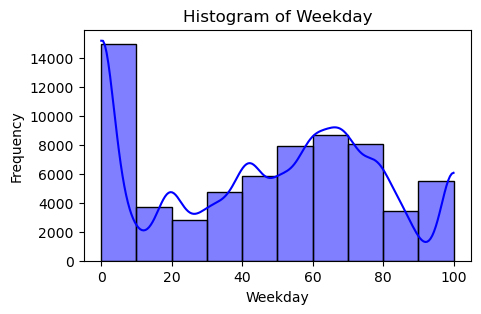

In [60]:
# Plotando o histograma
plt.figure(figsize=(5, 3))
sns.histplot(df_total["Weekday"], bins=10, color='blue', kde=True)

# Configurando os rótulos e título
plt.xlabel('Weekday')
plt.ylabel('Frequency')
plt.title('Histogram of Weekday')

# Mostrando o gráfico
plt.show()
plt.close()

# Q3 (não calculado)

In [7]:
def calculateQ3(state):
    df_filter_pr_state_filter = df_filter_pr_state[(df_filter_pr_state['State'] == state)]
    station_list = df_filter_pr_state_filter['Code'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
    df_q_outlier = pd.DataFrame(columns = ["Code", "Date", "Outlier"])
    count = 0
    print(state)
    for station in station_list:
        count = count + 1
        df_temp_station = df_filter_pr_state_filter[(df_filter_pr_state_filter['Code'] == station)]
        df_temp_station['Month'] = df_temp_station['Date'].dt.month
        df_threshold = df_temp_station[df_temp_station['Value']>= 1.0]
        df_threshold = df_threshold.reset_index(drop = True, inplace=False)
        df_month = pd.DataFrame(df_threshold['Month'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist(), columns=['Month'])
        df_month = df_month.sort_values(['Month'], ignore_index=True)
        list_month = df_month['Month'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
        upper_whisker_list = []
        for i in list_month:
            df_threshold_temp = df_threshold[(df_threshold['Month'] == i)]
        #     print(df_threshold_temp)
            first_quartile = df_threshold_temp['Value'].quantile(0.25)
            thrid_quartile = df_threshold_temp['Value'].quantile(0.75)
            iqr = thrid_quartile - first_quartile
            upper_whisker = thrid_quartile + 1.5 * iqr
            upper_whisker_list.append(upper_whisker)
#             print('iqr', iqr,"month", i)
#             print('thrid_quartile', thrid_quartile,"month", i)
#             print('upper_whisker', upper_whisker,"month", i)
#         print('upper_whisker_list',upper_whisker_list)
        df_quartile_threshold = pd.DataFrame(list(zip(list_month, upper_whisker_list)), columns =['Month', 'Upper Whisker'])
        print(count, '/', len(station_list))
        year_list = df_temp_station['Year'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
#         print(year_list)
        list_code = []
        list_date = []
        list_outlier= []
        for year in year_list:
            ### FILTERING BY YEAR ###
            df_temp_station_year = df_temp_station[(df_temp_station['Year'] == year)]
            df_temp_station_year['Month'] = df_temp_station_year['Date'].dt.month
            list_month = df_temp_station_year['Month'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
            for month in list_month:
                df_temp_station_month = df_temp_station_year[(df_temp_station_year['Month'] == month)]
                # count_ops = len(df_temp_station_month)
                # min_date = min(df_temp_station_month['Date'])
                # max_date = max(df_temp_station_month['Date'])
                first_day = datetime(year, month, 1)
                last_day = first_day + relativedelta.relativedelta(months=1)
                date_list = []
                today = first_day
                while today < last_day:
                    date_list.append(today)
                    today = today + timedelta(days=1)
                df_date_list = pd.DataFrame(date_list, columns=['Date'])
                df_analysis = df_date_list.merge(df_temp_station_month, how = 'left', on  = 'Date')
                df_analysis = df_analysis.sort_values(['Date'], ignore_index=True)
                len_period = len(df_analysis)
                df_merge = df_analysis.merge(df_quartile_threshold, how="left", on ='Month')
                df_merge['Validation Count'] = np.where(df_merge['Value'] > df_merge['Upper Whisker'], 0, 1)
                upper_validation = df_merge['Validation Count'].sum()
                q_outlier = 100.0 * upper_validation / len_period
    #             print(q_outlier)
                list_code.append(station)
                list_date.append(first_day)
                list_outlier.append(q_outlier)
    #     print(list_code)
    #     print(list_date)
        # print(list_outlier)
        df_station_outlier = pd.DataFrame(list(zip(list_code, list_date, list_outlier)),
                                             columns =['Code', 'Date', 'Outlier'])
        df_q_outlier = pd.concat([df_q_outlier, df_station_outlier], ignore_index = True)
        del df_station_outlier
        df_q_outlier['State'] = state
    df_q_outlier.to_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q3\MENSAL\UF\\"+state+r"_by_month.h5", 'table_data', mode = 'w', append = False, complevel = 9, encoding="cp860")


In [13]:
state_teste = "SE"
calculateQ3(state_teste)
for state in state_list:
    calculateQ3(state)
df_teste = pd.read_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q3\MENSAL\UF\\"+state_teste+r"_by_month.h5")
df_teste

SE
1 / 8
2 / 8
3 / 8
4 / 8
5 / 8
6 / 8
7 / 8
8 / 8
AC
1 / 22
2 / 22
3 / 22
4 / 22
5 / 22
6 / 22
7 / 22
8 / 22
9 / 22
10 / 22
11 / 22
12 / 22
13 / 22
14 / 22
15 / 22
16 / 22
17 / 22
18 / 22
19 / 22
20 / 22
21 / 22
22 / 22
AL
1 / 17
2 / 17
3 / 17
4 / 17
5 / 17
6 / 17
7 / 17
8 / 17
9 / 17
10 / 17
11 / 17
12 / 17
13 / 17
14 / 17
15 / 17
16 / 17
17 / 17
AM
1 / 53
2 / 53
3 / 53
4 / 53
5 / 53
6 / 53
7 / 53
8 / 53
9 / 53
10 / 53
11 / 53
12 / 53
13 / 53
14 / 53
15 / 53
16 / 53
17 / 53
18 / 53
19 / 53
20 / 53
21 / 53
22 / 53
23 / 53
24 / 53
25 / 53
26 / 53
27 / 53
28 / 53
29 / 53
30 / 53
31 / 53
32 / 53
33 / 53
34 / 53
35 / 53
36 / 53
37 / 53
38 / 53
39 / 53
40 / 53
41 / 53
42 / 53
43 / 53
44 / 53
45 / 53
46 / 53
47 / 53
48 / 53
49 / 53
50 / 53
51 / 53
52 / 53
53 / 53
AP
1 / 21
2 / 21
3 / 21
4 / 21
5 / 21
6 / 21
7 / 21
8 / 21
9 / 21
10 / 21
11 / 21
12 / 21
13 / 21
14 / 21
15 / 21
16 / 21
17 / 21
18 / 21
19 / 21
20 / 21
21 / 21
BA
1 / 89
2 / 89
3 / 89
4 / 89
5 / 89
6 / 89
7 / 89
8 / 89
9 / 89
10 

,Code,Date,Outlier,State
0,49550000,2021-01-01,100.000000,SE
1,49550000,2021-02-01,100.000000,SE
2,49550000,2021-03-01,100.000000,SE
3,49550000,2021-04-01,100.000000,SE
4,49550000,2021-05-01,93.548387,SE
...,...,...,...,...
173,50191000,2023-08-01,100.000000,SE
174,50191000,2023-09-01,100.000000,SE
175,50191000,2023-10-01,100.000000,SE
176,50191000,2023-11-01,100.000000,SE


In [14]:
all_files = glob.glob(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q3\MENSAL\UF\*.h5")
count = 0
df = []
for filename in all_files:
    df = pd.read_hdf(filename)
    df.reset_index(inplace=True, drop = True)
    if count == 0:
        df_total = df.copy(deep = True)
    else:
        df_total = pd.concat([df_total, df], ignore_index = True)
    count = count + 1
    print("File", count,"|", filename)
print(count, "files are loaded")
df_total.to_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q3\MENSAL\\"+r"TELEMETRIA_Q3_by_month.h5", 'table_data', mode = 'w', append = False, complevel = 9, encoding="cp860")
df_total

File 1 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q3\MENSAL\UF\AC_by_month.h5
File 2 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q3\MENSAL\UF\AL_by_month.h5
File 3 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q3\MENSAL\UF\AM_by_month.h5
File 4 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q3\MENSAL\UF\AP_by_month.h5
File 5 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q3\MENSAL\UF\BA_by_month.h5
File 6 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q3\MENSAL\UF\CE_by_month.h5
File 7 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q3\MENSAL\UF\DF_by_month.h5
File 8 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q3\MENSAL\UF\ES_by_month.h5
File 9 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q3\MENSAL\UF\GO_by_month.h5
File 10 | 

,Code,Date,Outlier,State
0,12370000,2021-01-01,100.000000,AC
1,12370000,2021-02-01,92.857143,AC
2,12370000,2021-03-01,93.548387,AC
3,12370000,2021-04-01,100.000000,AC
4,12370000,2021-05-01,96.774194,AC
...,...,...,...,...
65748,28850000,2023-08-01,100.000000,TO
65749,28850000,2023-09-01,100.000000,TO
65750,28850000,2023-10-01,96.774194,TO
65751,28850000,2023-11-01,100.000000,TO


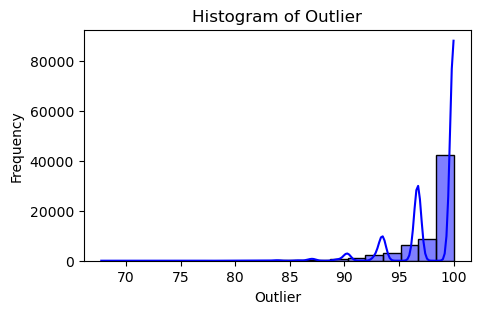

In [15]:
# Plotando o histograma
plt.figure(figsize=(5, 3))
sns.histplot(df_total["Outlier"], bins=20, color='blue', kde=True)

# Configurando os rótulos e título
plt.xlabel('Outlier')
plt.ylabel('Frequency')
plt.title('Histogram of Outlier')

# Mostrando o gráfico
plt.show()
plt.close()

# Q4

In [73]:
def calculateQ4(state):
    df_filter_pr_state_filter = df_filter_pr_state[(df_filter_pr_state['State'] == state)]
    station_list = df_filter_pr_state_filter['Code'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
    df_result = pd.DataFrame(columns = ["Code", "Date", "Repetition"])
    count = 0
    print(state)
    for station in station_list:
        count = count + 1
        list_gauge_code = []
        list_year = []
        list_q4_repetition = []
        df_temp_station = df_filter_pr_state_filter[(df_filter_pr_state_filter['Code'] == station)]
        year_list = df_temp_station['Year'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
        for year in year_list:
            df_temp_station_year = df_temp_station[(df_temp_station['Year'] == year)]
            df_temp_station_year['Month'] = df_temp_station_year['Date'].dt.month
            list_month = df_temp_station_year['Month'].drop_duplicates().reset_index(drop = True, inplace = False).values.tolist()
            # print(list_month)
            for month in list_month:
                df_temp_station_month = df_temp_station_year[(df_temp_station_year['Month'] == month)]
                first_day = datetime(year, month, 1)
                last_day = first_day + relativedelta.relativedelta(months=1)
                date_list = []
                today = first_day
                while today < last_day:
                    date_list.append(today)
                    today = today + timedelta(days=1)
                df_date_list = pd.DataFrame(date_list, columns=['Date'])      
                df_temp_station_month = df_date_list.merge(df_temp_station_month, how = 'left', on  = 'Date')
                df_temp_station_month = df_temp_station_month.sort_values(['Date'], ignore_index=True)
                pr_list = np.array(df_temp_station_month['Value'].values.tolist())
                max_rep = 0
                rep_count = 0
                rep_value = 0
                for i in range(len(pr_list)):
                    n = pr_list[i]
                    n_ant = pr_list[i-1]
                    if (i > 0 and n == n_ant and n > 0.2):
                        rep_count = rep_count + 1
                        if rep_count > max_rep and rep_count >= 1:
                            max_rep = rep_count
                            rep_value = n
                    else:
                        rep_count = 0
                print(state, station, first_day, 'rep_count', rep_count, 'max_rep', max_rep, 'rep_value', rep_value)
                if max_rep >= 1:
                    repetition = 0
                else:
                    repetition = 100
                list_gauge_code.append(station)
                list_year.append(first_day)
                list_q4_repetition.append(repetition)
        df_station_repetition = pd.DataFrame(list(zip(list_gauge_code, list_year, list_q4_repetition)), columns = ["Code", "Date", "Repetition"])
        if df_result.empty:
            df_result = df_station_repetition.copy(deep=True)
        else:
            df_result = pd.concat([df_result, df_station_repetition], ignore_index = True)
        del df_station_repetition
    df_result['State'] = state
    df_result.to_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q4\MENSAL\UF\\"+state+r"_by_month.h5", 'table_data', mode = 'w', append = False, complevel = 9, encoding="cp860") # type: ignore

In [74]:
state_teste = "SE"
# calculateQ4(state_teste)
for state in state_list:
    calculateQ4(state)
df_teste = pd.read_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q4\MENSAL\UF\\"+state_teste+r"_by_month.h5")
df_teste

AC
AC 12370000 2021-01-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2021-02-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2021-03-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2021-04-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2021-05-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2021-06-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2021-07-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2021-08-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2021-09-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2021-10-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2023-01-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2023-02-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2023-03-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2023-04-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 12370000 2023-08-01 00:00:00 rep_count 0 max_rep 0 rep_value 0
AC 1237

,Code,Date,Repetition,State
0,49550000,2021-01-01,100,SE
1,49550000,2021-02-01,100,SE
2,49550000,2021-03-01,100,SE
3,49550000,2021-04-01,0,SE
4,49550000,2021-05-01,100,SE
...,...,...,...,...
173,50191000,2023-08-01,100,SE
174,50191000,2023-09-01,100,SE
175,50191000,2023-10-01,100,SE
176,50191000,2023-11-01,100,SE


In [75]:
all_files = glob.glob(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q4\MENSAL\UF\*.h5")
count = 0
df = []
for filename in all_files:
    df = pd.read_hdf(filename)
    df.reset_index(inplace=True, drop = True)
    if count == 0:
        df_total = df.copy(deep = True)
    else:
        df_total = pd.concat([df_total, df], ignore_index = True)
    count = count + 1
    print("File", count,"|", filename)
print(count, "files are loaded")
df_total.to_hdf(general_path + r"\Consolidated Files\TELEMETRIA\QUALIDADE\Q4\MENSAL\\"+r"TELEMETRIA_Q4_by_month.h5", 'table_data', mode = 'w', append = False, complevel = 9, encoding="cp860")
df_total

File 1 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q4\MENSAL\UF\AC_by_month.h5
File 2 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q4\MENSAL\UF\AL_by_month.h5
File 3 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q4\MENSAL\UF\AM_by_month.h5
File 4 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q4\MENSAL\UF\AP_by_month.h5
File 5 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q4\MENSAL\UF\BA_by_month.h5
File 6 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q4\MENSAL\UF\CE_by_month.h5
File 7 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q4\MENSAL\UF\DF_by_month.h5
File 8 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q4\MENSAL\UF\ES_by_month.h5
File 9 | C:/Users/linde/OneDrive/Hidroweb\Consolidated Files\TELEMETRIA\QUALIDADE\Q4\MENSAL\UF\GO_by_month.h5
File 10 | 

,Code,Date,Repetition,State
0,12370000,2021-01-01,100,AC
1,12370000,2021-02-01,100,AC
2,12370000,2021-03-01,100,AC
3,12370000,2021-04-01,100,AC
4,12370000,2021-05-01,100,AC
...,...,...,...,...
65748,28850000,2023-08-01,100,TO
65749,28850000,2023-09-01,100,TO
65750,28850000,2023-10-01,100,TO
65751,28850000,2023-11-01,100,TO


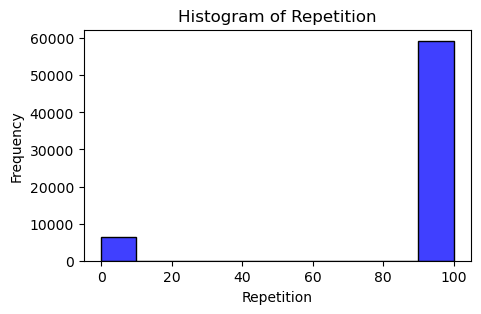

In [76]:
# Plotando o histograma
plt.figure(figsize=(5, 3))
sns.histplot(df_total["Repetition"], bins=10, color='blue', kde=False)

# Configurando os rótulos e título
plt.xlabel('Repetition')
plt.ylabel('Frequency')
plt.title('Histogram of Repetition')

# Mostrando o gráfico
plt.show()
plt.close()

In [77]:
# analise_visual_telemetria_rs.xlsx

df_visual_rs = pd.read_excel(general_path + '/Consolidated Files/TELEMETRIA/analise_visual_telemetria_rs.xlsx', sheet_name = 'consolidado')
df_visual_rs['gauge_code'] = df_visual_rs['gauge_code'].astype(str)
df_visual_rs

,gauge_code,quality,year
0,SBSM,LQ,2021
1,SBPK,LQ,2021
2,SBPA,HQ,2021
3,SBUG,LQ,2021
4,SBCO,LQ,2021
...,...,...,...
866,A893,HQ,2023
867,A894,HQ,2023
868,A895,HQ,2023
869,A897,HQ,2023


In [78]:
df_total_rs = df_total.copy(deep = True)
df_total_rs.columns = ["gauge_code", "date", "repetition", "state"]
df_total_rs = df_total_rs[df_total_rs['state'] == "RS"]
df_total_rs['year'] = df_total_rs['date'].dt.year
df_total_rs

,gauge_code,date,repetition,state,year
46505,70120000,2021-01-01,100,RS,2021
46506,70120000,2021-02-01,100,RS,2021
46507,70120000,2021-03-01,100,RS,2021
46508,70120000,2021-04-01,100,RS,2021
46509,70120000,2021-05-01,100,RS,2021
...,...,...,...,...,...
52801,88690050,2023-08-01,100,RS,2023
52802,88690050,2023-09-01,0,RS,2023
52803,88690050,2023-10-01,100,RS,2023
52804,88690050,2023-11-01,100,RS,2023


In [79]:
df_compare = pd.merge(df_total_rs, df_visual_rs, on = ['year', 'gauge_code'], how = 'left')
df_compare

,gauge_code,date,repetition,state,year,quality
0,70120000,2021-01-01,100,RS,2021,HQ
1,70120000,2021-02-01,100,RS,2021,HQ
2,70120000,2021-03-01,100,RS,2021,HQ
3,70120000,2021-04-01,100,RS,2021,HQ
4,70120000,2021-05-01,100,RS,2021,HQ
...,...,...,...,...,...,...
6296,88690050,2023-08-01,100,RS,2023,LQ
6297,88690050,2023-09-01,0,RS,2023,LQ
6298,88690050,2023-10-01,100,RS,2023,LQ
6299,88690050,2023-11-01,100,RS,2023,LQ


In [1]:
fig, ax = plt.subplots(figsize = (5, 5))

variable = 'repetition' 
df_hq = df_compare[df_compare['quality'] == 'HQ']
df_lq = df_compare[df_compare['quality'] == 'LQ']
p_availability_hq = df_hq[variable].mean()
p_availability_lq = df_lq[variable].mean()
# Determine the bin width
bin_width = 20 # Adjust as needed
# Calculate bin edges
data_min = math.floor(min(df_hq[variable].min(), df_lq[variable].min())/10)*10
data_max = max(df_hq[variable].max(), df_lq[variable].max())
bins = np.arange(data_min, data_max + bin_width, bin_width)

# Plot data on each subplot
ax.hist(df_hq[variable], bins=bins, alpha=0.7, label='HQ', color='blue', edgecolor='black')
ax.hist(df_lq[variable], bins=bins, alpha=0.3, label='LQ', color='red', edgecolor='black')
ax.set_xlim(0, 100)
ax.set_ylim(0, 4000)

ax.legend()
ax.set_xlabel(variable)
ax.set_ylabel('Frequency')

NameError: name 'plt' is not defined